<a href="https://colab.research.google.com/github/mkuczynski11/pug-project/blob/main/PUG_Optymized.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

### Imports

In [1]:
import numpy as np
import os
import PIL
import PIL.Image
import tensorflow as tf
import tensorflow_datasets as tfds
import pathlib

### Tensorboard and HParams setup

In [2]:
# Load the TensorBoard notebook extension
%load_ext tensorboard

In [3]:
# # Clear any logs from previous runs
# !rm -rf /content/gdrive/MyDrive/PUG/opt_logs

In [4]:
import tensorflow as tf
from tensorboard.plugins.hparams import api as hp

### Setup training and validation datasets

In [5]:
BATCH_SIZE_TRAINING = 100
BATCH_SIZE_VALIDATION = 50
DENSE_LAYER_ACTIVATION = 'softmax'
CLASS_MODE='categorical'
OBJECTIVE_FUNCTION='categorical_crossentropy'
LOSS_METRICS=['accuracy']
EARLY_STOP_PATIENCE = 3
STEPS_PER_EPOCH_TRAINING = 10

In [3]:
# Usage of google drive where we are storing our data
from google.colab import drive
drive.mount('/content/gdrive')

data_dir = '/content/gdrive/MyDrive/PUG/garbage_classification' # directory of your data
!rm -rf /content/gdrive/MyDrive/PUG/garbage_classification/.ipynb_checkpoints/

Mounted at /content/gdrive


In [7]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator

data_generator_128 = ImageDataGenerator(
    validation_split=0.2
)

In [8]:
train_ds_128 = data_generator_128.flow_from_directory(
    data_dir,
    target_size=(128, 128),
    batch_size=BATCH_SIZE_TRAINING,
    class_mode=CLASS_MODE
)

Found 15515 images belonging to 12 classes.


In [9]:
val_ds_128 = data_generator_128.flow_from_directory(
    data_dir,
    target_size=(128, 128),
    batch_size=BATCH_SIZE_VALIDATION,
    class_mode=CLASS_MODE,
    subset='validation'
)

Found 3100 images belonging to 12 classes.


In [10]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator

data_generator_224 = ImageDataGenerator(
    validation_split=0.2
)

In [11]:
train_ds_224 = data_generator_224.flow_from_directory(
    data_dir,
    target_size=(224, 224),
    batch_size=BATCH_SIZE_TRAINING,
    class_mode=CLASS_MODE
)

Found 15515 images belonging to 12 classes.


In [12]:
val_ds_224 = data_generator_224.flow_from_directory(
    data_dir,
    target_size=(224, 224),
    batch_size=BATCH_SIZE_VALIDATION,
    class_mode=CLASS_MODE,
    subset='validation'
)

Found 3100 images belonging to 12 classes.


In [13]:
class_names = []
for key in train_ds_224.class_indices.keys():
  class_names.append(key)

print(class_names)


['battery', 'biological', 'brown-glass', 'cardboard', 'clothes', 'green-glass', 'metal', 'paper', 'plastic', 'shoes', 'trash', 'white-glass']


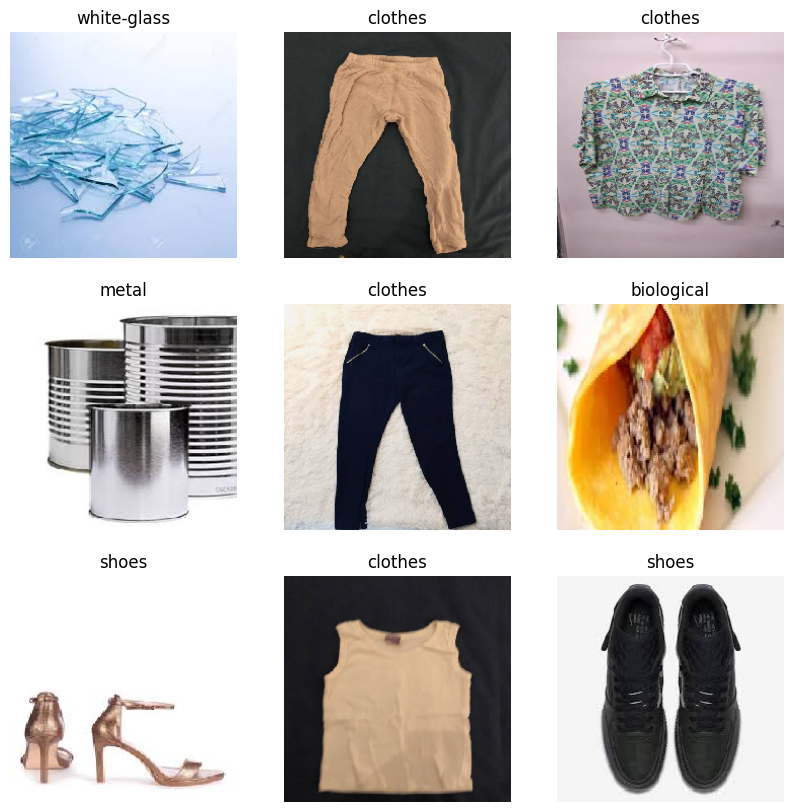

In [ ]:
import matplotlib.pyplot as plt

plt.figure(figsize=(10, 10))
for i in range(9):
  ax = plt.subplot(3, 3, i + 1)
  plt.imshow(train_ds_224[0][0][i].astype('uint8'))
  index = np.argmax(train_ds_224[0][1][i])
  plt.title(class_names[index])
  plt.axis("off")

### Define model and training function

In [14]:
HP_NUM_UNITS = hp.HParam('num_units', hp.Discrete([32, 64]))
HP_CNN = hp.HParam('cnn', hp.Discrete(["https://tfhub.dev/google/imagenet/mobilenet_v1_100_128/feature_vector/5", "https://tfhub.dev/google/imagenet/mobilenet_v2_140_224/feature_vector/5"]))
HP_DROPOUT = hp.HParam('dropout', hp.RealInterval(0.0, 0.2))

METRIC_ACCURACY = 'accuracy'

with tf.summary.create_file_writer(f'/content/gdrive/MyDrive/PUG/opt_logs_2/hparam_tuning').as_default():
  hp.hparams_config(
    hparams=[HP_NUM_UNITS, HP_CNN, HP_DROPOUT],
    metrics=[hp.Metric(METRIC_ACCURACY, display_name='Accuracy')],
  )

In [15]:
cnn_params = {
    "https://tfhub.dev/google/imagenet/mobilenet_v1_100_128/feature_vector/5": {
        "train_ds": train_ds_128,
        "val_ds": val_ds_128,
    },
    "https://tfhub.dev/google/imagenet/mobilenet_v2_140_224/feature_vector/5": {
        "train_ds": train_ds_224,
        "val_ds": val_ds_224,
    }
}

In [16]:
early_stopping = tf.keras.callbacks.EarlyStopping(
    monitor='val_loss',
    patience=EARLY_STOP_PATIENCE
)

In [17]:
import tensorflow_hub as hub
from tensorflow.keras import optimizers

def train_test_model(run_dir, hparams):
  base_model_path = f'/content/gdrive/MyDrive/PUG/opt_models_2/best_model:{hparams[HP_NUM_UNITS]}:{hparams[HP_CNN]}:{hparams[HP_DROPOUT]}.h5'

  model_checkpoint = tf.keras.callbacks.ModelCheckpoint(
      base_model_path,
      save_best_only=True
  )


  num_classes = cnn_params[hparams[HP_CNN]]["train_ds"].num_classes

  model = tf.keras.Sequential()
  model.add(tf.keras.layers.Rescaling(1./255))
  model.add(hub.KerasLayer(hparams[HP_CNN], trainable=False))
  model.add(tf.keras.layers.BatchNormalization())
  # model.add(tf.keras.layers.Dense(96, activation='relu'))
  # model.add(tf.keras.layers.BatchNormalization())
  model.add(tf.keras.layers.Dense(hparams[HP_NUM_UNITS], activation='relu'))
  model.add(tf.keras.layers.BatchNormalization())
  model.add(tf.keras.layers.Dense(num_classes, activation=DENSE_LAYER_ACTIVATION))

  model.compile(optimizer='adam',
              loss=OBJECTIVE_FUNCTION,
              metrics=LOSS_METRICS)

  model.fit(
    cnn_params[hparams[HP_CNN]]["train_ds"],
    steps_per_epoch=STEPS_PER_EPOCH_TRAINING,
    validation_data=cnn_params[hparams[HP_CNN]]["val_ds"],
    epochs=100,
    callbacks=[early_stopping, model_checkpoint, tf.keras.callbacks.TensorBoard(run_dir, histogram_freq=1), hp.KerasCallback(run_dir, hparams)]
  )

  # # Also add epochs that model has been trained on
  # import sys
  # original_stdout = sys.stdout # Save a reference to the original standard output
  # with open(f'/content/gdrive/MyDrive/PUG/opt_models_2/best_model:{hparams[HP_NUM_UNITS]}:{hparams[HP_CNN]}:{hparams[HP_DROPOUT]}.txt', 'w') as f:
  #     sys.stdout = f # Change the standard output to the file we created.
  #     model.summary()
  #     sys.stdout = original_stdout # Reset the standard output to its original value
  loss, acc = model.evaluate(cnn_params[hparams[HP_CNN]]["val_ds"])
  return loss, acc

### Train model

In [18]:
session_num = 0

for num_units in HP_NUM_UNITS.domain.values:
  for dropout_rate in (HP_DROPOUT.domain.min_value, HP_DROPOUT.domain.max_value):
    for cnn in HP_CNN.domain.values:
      hparams = {
          HP_NUM_UNITS: num_units,
          HP_CNN: cnn,
          HP_DROPOUT: dropout_rate,
      }
      run_name = "run-%d" % session_num
      print('--- Starting trial: %s' % run_name)
      print({h.name: hparams[h] for h in hparams})
      train_test_model('/content/gdrive/MyDrive/PUG/opt_logs_2/hparam_tuning/' + run_name, hparams)
      session_num += 1

--- Starting trial: run-0
{'num_units': 32, 'cnn': 'https://tfhub.dev/google/imagenet/mobilenet_v1_100_128/feature_vector/5', 'dropout': 0.0}
Epoch 1/100
10/10 [==============================] - ETA: 0s - loss: 2.0872 - accuracy: 0.3210 

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3079: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


10/10 [==============================] - 755s 81s/step - loss: 2.0872 - accuracy: 0.3210 - val_loss: 1.4467 - val_accuracy: 0.5161
Epoch 2/100
10/10 [==============================] - 155s 16s/step - loss: 1.1577 - accuracy: 0.6470 - val_loss: 1.0186 - val_accuracy: 0.6842
Epoch 3/100
10/10 [==============================] - 186s 19s/step - loss: 0.8404 - accuracy: 0.7980 - val_loss: 0.8356 - val_accuracy: 0.7303
Epoch 4/100
10/10 [==============================] - 139s 14s/step - loss: 0.6895 - accuracy: 0.8250 - val_loss: 0.7090 - val_accuracy: 0.7652
Epoch 5/100
10/10 [==============================] - 123s 13s/step - loss: 0.5831 - accuracy: 0.8700 - val_loss: 0.6252 - val_accuracy: 0.7971
Epoch 6/100
10/10 [==============================] - 119s 12s/step - loss: 0.5911 - accuracy: 0.8390 - val_loss: 0.5601 - val_accuracy: 0.8229
Epoch 7/100
10/10 [==============================] - 114s 11s/step - loss: 0.4846 - accuracy: 0.8850 - val_loss: 0.5081 - val_accuracy: 0.8390
Epoch 8/100

In [4]:
%tensorboard --logdir /content/gdrive/MyDrive/PUG/opt_logs_2/hparam_tuning/

<IPython.core.display.Javascript object>